In [7]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score
import folium
import io
from PIL import Image

In [2]:
# Import the april dataset
april_s10=pd.read_csv('/Users/ildem/Desktop/Project_8/april_10.csv')

In [3]:
# Take Lat and Lon columns into a new data frame 
data_s10=april_s10.iloc[:,1:3]

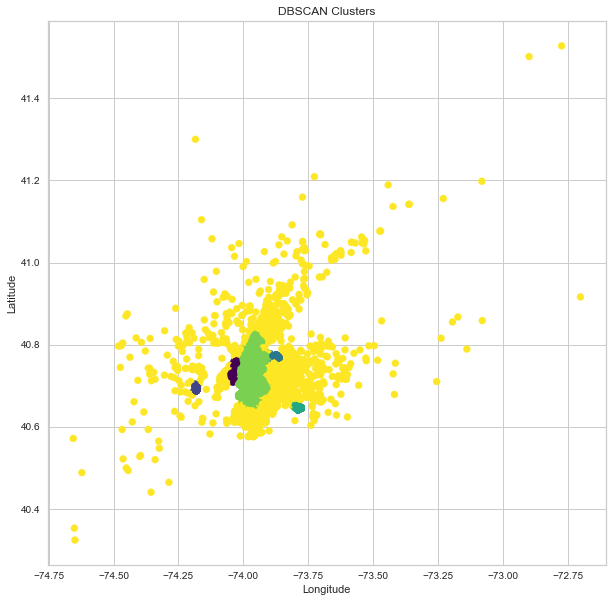

In [16]:
# Clustering with DBSCAN
dbscan = DBSCAN(eps=0.01, min_samples=100, n_jobs=-1)
y_dbscan = dbscan.fit_predict(data_s10)

plt.figure(figsize=(10, 10))
plt.scatter(data_s10.Lon, data_s10.Lat, c=y_dbscan, cmap='viridis_r')
plt.title('DBSCAN Clusters')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [5]:
# Check the number of clusters
dbscan_df=data_s10
dbscan_df['labels']=dbscan.labels_
dbscan_df['labels'].value_counts()

 0    51462
-1     1959
 1     1142
 2     1121
 4      458
 3      310
Name: labels, dtype: int64

In [6]:
print('Silhouette score for DBSCAN is', silhouette_score(data_s10, dbscan.labels_))
print('Davies-Bouldin score for DBSCAN is', davies_bouldin_score(data_s10, dbscan.labels_))

Silhouette score for DBSCAN is 0.9573876836557432
Davies-Bouldin score for DBSCAN is 0.09474376340743335


In [8]:
dbcluster1 = dbscan_df[['Lat','Lon']][dbscan_df['labels']==0].values.tolist()
dbcluster2 = dbscan_df[['Lat','Lon']][dbscan_df['labels']==1].values.tolist()
dbcluster3 = dbscan_df[['Lat','Lon']][dbscan_df['labels']==2].values.tolist()
dbcluster4 = dbscan_df[['Lat','Lon']][dbscan_df['labels']==3].values.tolist()
dbcluster5 = dbscan_df[['Lat','Lon']][dbscan_df['labels']==4].values.tolist()
dbcluster6 = dbscan_df[['Lat','Lon']][dbscan_df['labels']==-1].values.tolist()

In [17]:
# Generate the map with all points in the sample data and the cluster centers
db_map= folium.Map(location=[40.74, -73.97], zoom_start=10, tiles='Stamen Toner', prefer_canvas=True)


for i in range(0, len(dbcluster1)):
    folium.CircleMarker(dbcluster1[i], radius=1 ,color='lightgreen').add_to(db_map)

for i in range(0, len(dbcluster2)):
    folium.CircleMarker(dbcluster2[i], radius=1 ,color='cadetblue').add_to(db_map)

for i in range(0, len(dbcluster3)):
    folium.CircleMarker(dbcluster3[i], radius=1 ,color='blue').add_to(db_map)

for i in range(0, len(dbcluster4)):
    folium.CircleMarker(dbcluster4[i], radius=1 ,color='darkblue').add_to(db_map)

for i in range(0, len(dbcluster5)):
    folium.CircleMarker(dbcluster5[i], radius=1 ,color='purple').add_to(db_map)

for i in range(0, len(dbcluster6)):
    folium.CircleMarker(dbcluster6[i], radius=1 ,color='yellow').add_to(db_map)    


In [18]:
db_map